# Homework 2 (100 Points)

The goal of this homework is to get more practice with pandas and get practice with clustering on various datasets.


## Exercise 1 - (60 points)

This exercise will be using the [Airbnb dataset](http://insideairbnb.com/get-the-data.html) for NYC called `listings.csv`. You can download it directly [here](http://data.insideairbnb.com/united-states/ny/new-york-city/2021-11-02/visualisations/listings.csv)

a) Produce a Heatmap using the Folium package (you can install it using pip) of the mean listing price per location (lattitude and longitude) over the NYC map. (5 points)

Hints:
1. generate a base map of NYC to plot over: default_location=[40.693943, -73.985880] 
2. generate an HTML file named `index.html` - open it in your browser and you'll see the heatmap 



In [11]:
import numpy as np
import pandas as pd
import folium
from folium import plugins
from folium.plugins import HeatMap

default_location=[40.693943, -73.985880]

df_nycdf = pd.read_csv('listings.csv', dtype = object)
df_nyc = pd.read_csv('listings.csv')
map = folium.Map(location = default_location, zoom_start = 12)
info = list((zip(df_nyc['latitude'],df_nyc['longitude'],df_nyc['price'])))
heat = HeatMap(data=info)
heat.add_to(map)
map

/var/folders/ks/vzxfw4ks2qqgpbl6l3n_3mkr0000gn/T/ipykernel_12795/1226315957.py:10: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_nyc = pd.read_csv('listings.csv')


b) Normalize the price by subtracting the mean and dividing by the standard deviation. Then reproduce the heatmap from a). Comment on any differences you observe. - (5 points )



In [12]:
df_nyc1 = pd.read_csv('listings.csv')
df_mean_price = df_nyc['price'].mean()
df_normalized_price = (df_nyc1['price']- df_mean_price/df_nyc1['price'].std())

newmap = folium.Map(location = default_location, zoom_start = 12)
heat_norm = list((zip(df_nyc1['latitude'],df_nyc1['longitude'],df_normalized_price)))
heat = HeatMap(data=heat_norm)
heat.add_to(newmap)
newmap


/var/folders/ks/vzxfw4ks2qqgpbl6l3n_3mkr0000gn/T/ipykernel_12795/92152765.py:1: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_nyc1 = pd.read_csv('listings.csv')


-> your answer here

c) Normalize the original price using sklearn's [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) to the interval [0,1]. Then reproduce the Heatmap from a). Comment on any differences you observe.  - (5 points)



In [13]:
from sklearn.preprocessing import MinMaxScaler

scale = MinMaxScaler()

df_nyc1['price'] = scale.fit_transform(df_nyc1[['price']])



map3 = folium.Map(location = default_location, zoom_start = 12)
info = list((zip(df_nyc['latitude'],df_nyc['longitude'],df_nyc['price'])))
heat = HeatMap(data=info)
heat.add_to(map3)
map3

-> your answer here

d) Plot a bar chart of the average price (un-normalized) per room type. Briefly comment on the relation between price and room type. - (2.5 points)


/var/folders/ks/vzxfw4ks2qqgpbl6l3n_3mkr0000gn/T/ipykernel_12795/3212338377.py:1: DtypeWarning: Columns (17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_nyc2 = pd.read_csv("listings.csv")


<AxesSubplot: xlabel='room_type'>

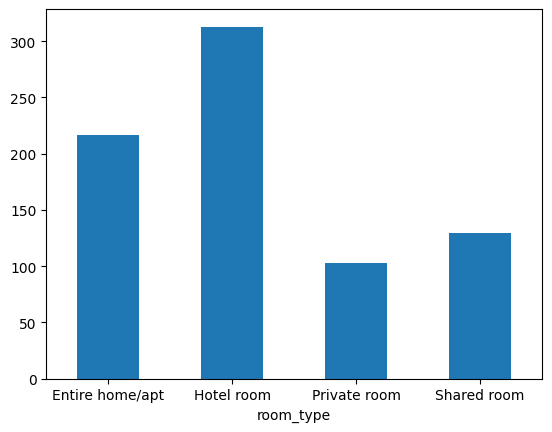

In [14]:
df_nyc2 = pd.read_csv("listings.csv")

avg_price = df_nyc2.groupby(['room_type'])['price'].mean()

avg_price.plot.bar(rot = 0)

-> your answer here

e) Plot on the NYC map the top 10 most expensive listings - (2.5 points)

In [15]:
most_expensive = df_nyc1.nlargest(n= 10, columns = 'price')

expensive = folium.Map(location = default_location, zoom_start = 12)
heat_map = HeatMap(data = list((zip(most_expensive['latitude'],most_expensive['longitude'],most_expensive['price']))))
heat_map.add_to(expensive)
expensive


f) Plot on the NYC map the top 10 most reviewed listings - (2.5 points)


In [16]:
most_expensive = df_nyc1.nlargest(n= 10, columns = 'number_of_reviews')

expensive = folium.Map(location = default_location, zoom_start = 12)
heat_map = HeatMap(data = list((zip(most_expensive['latitude'],most_expensive['longitude'],most_expensive['number_of_reviews']))))
heat_map.add_to(expensive)
expensive


g) Plot on the NYC map the top 10 most available listings - (2.5 points)

In [17]:
most_expensive = df_nyc1.nlargest(n= 10, columns = 'availability_365')

expensive = folium.Map(location = default_location, zoom_start = 12)
heat_map = HeatMap(data = list((zip(most_expensive['latitude'],most_expensive['longitude'],most_expensive['availability_365']))))
heat_map.add_to(expensive)
expensive


h) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Kmeans to create 5 clusters. Plot the points on the NYC map in a color corresponding to their cluster. - (10 points)


In [37]:
from sklearn.cluster import KMeans
import geopandas
import folium
from folium import plugins
from folium.plugins import HeatMap
import matplotlib
import mapclassify

df = df_nyc1[['latitude','longitude','price','number_of_reviews']]
colors = ['red','blue','green','purple', 'orange'] 
kmeans = KMeans (5, random_state=0).fit(df. values)
labels = list(kmeans. labels_)
m = folium.Map(location=default_location)
for index, row in df.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']], radius=1, color=colors[labels[index]]).add_to(m)
m.save ("indexH.html")

m




i) You should see points in the same cluster all over the map - briefly explain why that is. - (2.5 points)

most of the prices are around the same so theyll be in the same clusters

j) How many clusters would you recommend using instead of 5? Display and interpret either the silhouette scores or the elbow method. - (5 points)

In [32]:
from sklearn.metrics import silhouette_samples, silhouette_score

clusterdf =  df_nyc1[['longitude', 'latitude', 'price', 'number_of_reviews']]

label = ['price','number_of_reviews']

kmeans  = KMeans(n_clusters = 2, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 2: %.3f'%score)

kmeans = KMeans(n_clusters = 3, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 3: %.3f'%score)

kmeans  = KMeans(n_clusters = 4, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 4: %.3f'%score)

kmeans  = KMeans(n_clusters = 5, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 5: %.3f'%score)

kmeans  = KMeans(n_clusters = 6, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 6: %.3f'%score)

kmeans  = KMeans(n_clusters = 7, random_state = 0)
kmeans.fit_predict(clusterdf)
score = silhouette_score(clusterdf, kmeans.labels_, metric = 'euclidean')
print('Silhouette score of 7: %.3f'%score)



Silhouette score of 2: 0.847
Silhouette score of 3: 0.808
Silhouette score of 4: 0.787
Silhouette score of 5: 0.764
Silhouette score of 6: 0.739
Silhouette score of 7: 0.712


I would only use 2 since it has the highest test score

k) Would you recommend normalizing the price and number of reviews? Briefly explain why. - (5 points)

Yes I would as it would kmake it easier to read the data as well

yes it would be easier to interpret since they would all be at the same scale though they ahave different value ranges. By putting them on the same scale it makes them easier to see

l) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. - (5 points)


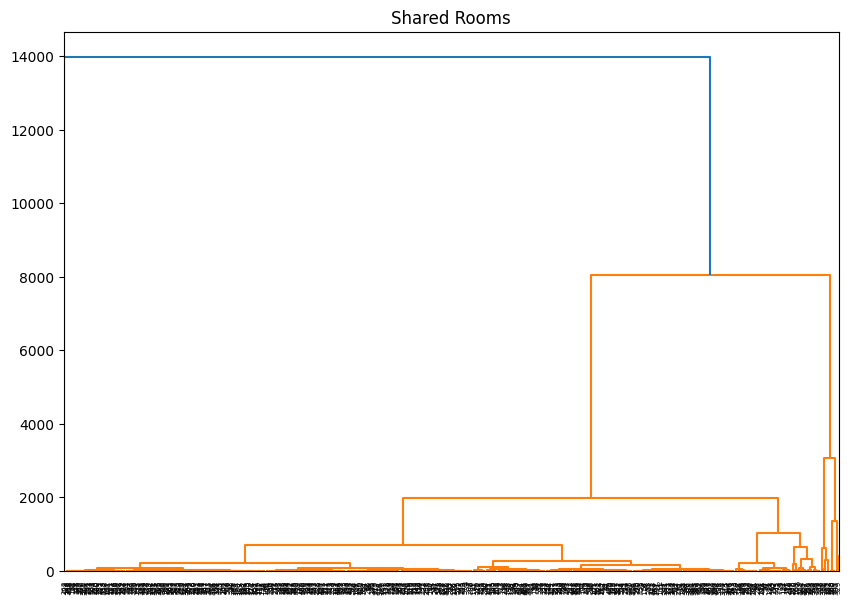

In [23]:
import numpy as np
from sklearn.preprocessing import normalize
from matplotlib import pyplot as plt
import scipy.cluster.hierarchy as dendro
import sklearn.cluster

pointsdf = df_nyc[['longitude', 'latitude', 'price', 'room_type']]
points_group = pointsdf.groupby(['room_type'])
points = pointsdf.loc[points_group.groups['Shared room']]

points = points.drop("room_type", axis=1)
scaled = pd.DataFrame(points, columns = points.columns)

plt.figure(figsize = (10,7))
plt.title("Shared Rooms")
dend = dendro.dendrogram(dendro.linkage(scaled, method = 'ward'))

m) briefly comment on what you observe from the structure of the dendrogram.  - (2.5 points)

It looks like a big cluster is created with shared rooms as subsets

n) Normalize the `price` as in b) and repeat l) - (5 points)

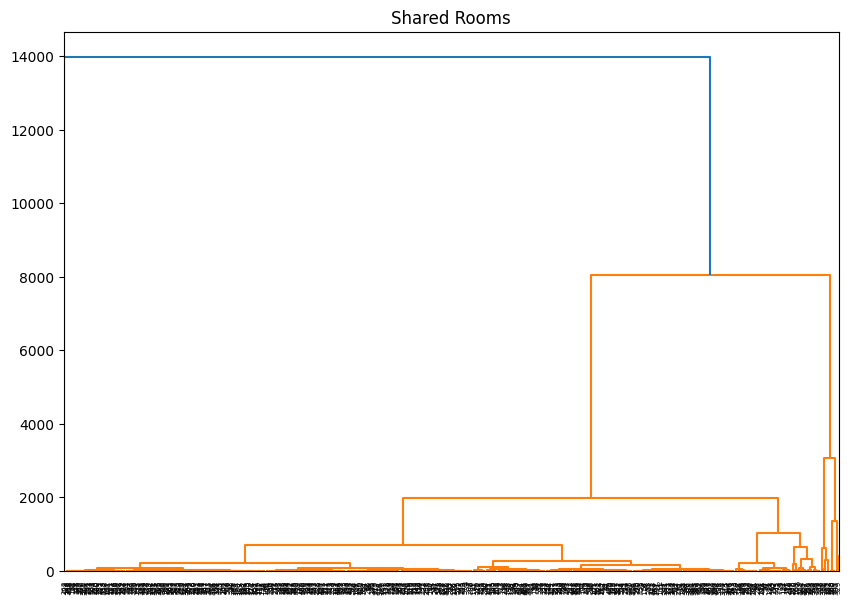

In [24]:
pointsdf = df_nyc[['longitude', 'latitude', 'price', 'room_type']]
points_group = pointsdf.groupby(['room_type'])
points = pointsdf.loc[points_group.groups['Shared room']]

points = points.drop("room_type", axis=1)
scaled  = normalize(points)
scaled = pd.DataFrame(points, columns = points.columns)

plt.figure(figsize = (10,7))
plt.title("Shared Rooms")
dend = dendro.dendrogram(dendro.linkage(scaled, method = 'ward'))

## Exercise 2 (40 points)

This exercise will be using the [mnist dataset](http://yann.lecun.com/exdb/mnist/).

a) Using Kmeans, cluster the images using 10 clusters and plot the centroid of each cluster. - (10 points)

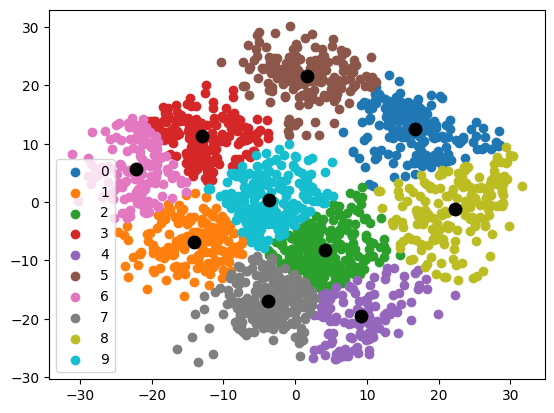

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
import numpy as np

mnist = load_digits().data
pca = PCA(2)
df = pca.fit_transform(mnist)
cluster = KMeans(n_clusters = 10, init = "k-means++",)
label = cluster.fit_predict(df)
centroids = cluster.cluster_centers_

filtered_label0 = df[label == 0]

 
u_labels = np.unique(label)
for i in u_labels:
    plt.scatter(df[label == i , 0] , df[label == i , 1] , label = i)
plt.scatter(centroids[:,0] , centroids[:,1] , s = 80, color = 'k')

plt.legend()
plt.show()



b) what is the disagreement distance between the clustering you created above and the clustering created by the labels attached to each image? Briefly explain what this number means in this context. - (10 points)

In [44]:
mnist = load_digits().data
pca = PCA(2)
df = pca.fit_transform(mnist)
cluster = KMeans(n_clusters = 10, init = "k-means++")
label = cluster.fit_predict(df)
centroids = cluster.cluster_centers_

filtered_label0 = df[label == 0]
centroids = cluster.cluster_centers_
df = pd.DataFrame(kmeans.predict (mnist.data))
def inc_dist(arr):
    distance = 0
    for i in range(len (arr)) :
        for j in range(len (arr)-(i+1)):
            distance += arr[i]*arr[j+(i+1)]
    return distance
dist = 0
for i in range(10):
    current = pd.Series (centroids) [lambda x: x==i].index.tolist()
    values = df[df.index.isin(current)].value_counts().tolist()
    dist += inc_dist (values)
print (dist)

NameError: name 'load_digits' is not defined

c) Download the CIFAR-10 dataset [here](https://www.cs.toronto.edu/~kriz/cifar.html). Open `batch_1` by following the documentation on the web page. Plot a random image from the dataset. - (10 points)

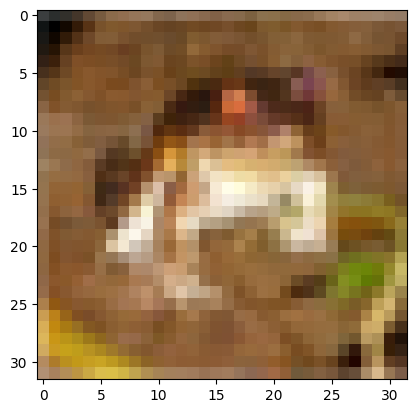

In [43]:
import os
import matplotlib.pyplot as plt
def unpickle(file):
    import pickle
    with open(file, 'rb') as fo:
        dict = pickle.load(fo, encoding='bytes')
    return dict

file ="batches/data_batch_1"
data = unpickle(file)

a = data[b'data']
X = a.reshape(10000, 3 , 32, 32).transpose(0,2,3,1).astype("uint8")


plt.imshow(X[0])


d) This image is 32 x 32 pixels and each pixel is a 3-dimensional object of RGB (Red, Green, Blue) intensities. Using the same image as in c), produce an image that only uses 4 colors (the 4 centroids of the clusters obtained by clustering the image itself using Kmeans). - (10 points)

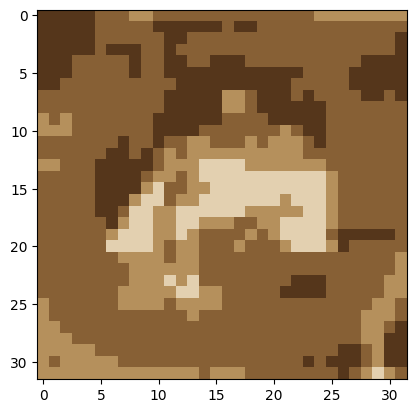

In [50]:
from collections import Counter
#data = unpickle(file)
(h,w,c) = X[0].shape
img2D = X[0].reshape(h*w,c)
#print(img2D)
#print(img2D.shape)
kmeans_model = KMeans(n_clusters=4) 
cluster_labels = kmeans_model.fit_predict(img2D)
labels_count = Counter(cluster_labels)
#print(labels_count)

rgb_cols = kmeans_model.cluster_centers_.round(0).astype(int)
img_quant = np.reshape(rgb_cols[cluster_labels],(h,w,c))
plt.imshow(img_quant)